In [1]:
import pickle
with open('crc_20x_tumor_graph.pkl', 'rb') as f:
    loaded_object = pickle.load(f)

data_list = loaded_object

In [2]:
import torch
import torch.nn as nn
import sys

In [3]:
EMBEDDING_DIM = 1536

## Try with 20X patches graph and two layer of graph transformmer

In [4]:
sys.path.append('..')
from utils.train_utils import accuracy
from sklearn.metrics import f1_score, roc_auc_score


def train_20x(model, train_loader, optimizer, criterion, device):
    model.train()
    total_loss = 0
    total_acc = 0
    all_preds = []
    all_labels = []

    for batch in train_loader:
        data_5x = batch
        if data_5x.edge_index.shape[0] < 2:
            continue
        data_5x= data_5x.to(device)
        optimizer.zero_grad()
        output = model(data_5x)
        loss = criterion(output, data_5x.y.long())
        
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

        acc = accuracy(output, data_5x.y.long())
        total_acc += acc.item()
        preds = torch.argmax(output, dim=1).cpu().numpy()
        labels = data_5x.y.cpu().numpy()
        all_preds.extend(preds)
        all_labels.extend(labels)

    average_loss = total_loss / len(train_loader)
    average_acc = total_acc / len(train_loader)
    f1 = f1_score(all_labels, all_preds, average='weighted')
    auc = roc_auc_score(all_labels, all_preds)
    return average_loss, average_acc, f1, auc

def valid_20x(model, val_loader, criterion, device):
    model.eval()
    total_loss = 0
    total_acc = 0
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for batch in val_loader:
            data_5x = batch
            if data_5x[0]['edge_index'].shape[0]<2:
                continue
            data_5x = data_5x.to(device)
            output = model(data_5x)
            loss = criterion(output, data_5x.y.long())
            acc = accuracy(output, data_5x.y.long())
            total_acc += acc.item()
            total_loss += loss.item()

            preds = torch.argmax(output, dim=1).cpu().numpy()
            labels = data_5x.y.cpu().numpy()
            all_preds.extend(preds)
            all_labels.extend(labels)

    average_loss = total_loss / len(val_loader)
    average_acc = total_acc / len(val_loader)
    f1 = f1_score(all_labels, all_preds, average='weighted')
    auc = roc_auc_score(all_labels, all_preds)

    return average_loss, average_acc, f1, auc

/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/pandas/core/computation/expressions.py:21: UserWarning: Pandas requires version '2.8.4' or newer of 'numexpr' (version '2.7.3' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED


In [5]:
from sklearn.model_selection import train_test_split
from torch_geometric.data import Data, DataLoader
import pandas as pd

# train_dataset, val_dataset = train_test_split(data_list, test_size=0.2, random_state=42)
# train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)
# val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False)

In [6]:
crc20x_tumor_df = pd.read_hdf('20x_crc_embeddings.h5')
image_id_res_df = image_id_res_df = pd.read_csv('../get_data/data_sheets/image_id_res.csv')

id_list=list(crc20x_tumor_df.ids.unique())
responses = list(image_id_res_df[image_id_res_df['images_id'].isin([int(x) for x in id_list])].ORR)
len(list(responses))

104

In [7]:
crc20x_tumor_df

,0,1,2,3,4,5,6,7,8,9,...,1535,ids,coord1,coord2,drug_response,data_source,cluster,cluster_number,is_include,is_tumor
0,-0.713385,-1.437152,0.596422,-0.435814,-0.162651,-0.086121,0.248144,0.913296,0.062546,-0.466292,...,0.245853,225441,34160.0,20984.0,0,CRC,44,44,N,Yes
1,-0.345455,-2.189390,0.074851,0.660547,-1.719994,0.139758,0.203159,1.090907,-1.275221,0.422933,...,-0.727646,225441,8296.0,7320.0,0,CRC,44,44,N,No
2,-0.317509,-1.817904,0.355642,0.078800,0.014659,1.242235,0.085924,-0.321047,-0.951605,0.442494,...,-0.804359,225441,29768.0,17080.0,0,CRC,21,21,Y,Yes
3,-0.479113,-1.779146,0.205956,-0.071254,-0.132548,0.313982,0.299431,0.673270,0.244911,0.983710,...,-0.088585,225441,29280.0,18056.0,0,CRC,47,47,Y,Yes
4,-0.659824,-1.072435,-0.651634,-0.750512,-0.576226,-0.522855,0.080675,0.818527,-0.266628,0.179119,...,-0.326234,225441,33672.0,21472.0,0,CRC,46,46,N,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
723828,-0.606073,0.467184,1.375417,0.437164,1.039197,-0.529705,-0.064332,0.131208,1.558076,1.080192,...,0.150385,225307,144451.0,12200.0,0,CRC,35,35,N,Yes
723829,0.269156,-0.433573,-0.043676,-1.197425,-0.229186,1.213833,0.756378,-1.556003,0.146218,0.184709,...,0.054427,225307,91258.0,57097.0,0,CRC,2,2,Y,No
723830,-0.223377,0.175732,0.908863,0.148045,1.227049,-0.503160,0.090021,1.155408,0.582418,-0.163367,...,-0.568499,225307,128346.0,51241.0,0,CRC,35,35,N,No
723831,-1.062760,0.211620,1.829159,1.666255,-0.684070,1.283037,0.106339,-1.089261,-0.195683,-0.757557,...,0.317653,225307,64417.0,62465.0,0,CRC,30,30,N,Yes


In [8]:
from sklearn.model_selection import StratifiedShuffleSplit
from torch_geometric.loader import DataLoader
from torch.utils.data import Subset
#363
stratified_split = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=363)
for train_index, test_index in stratified_split.split(data_list, responses):
# for train_index, test_index in stratified_split.split(data_list, stratification_targets):
    train_loader = DataLoader(Subset(data_list, train_index), batch_size=1, shuffle=True)
    val_loader = DataLoader(Subset(data_list, test_index), batch_size=1, shuffle=False)

In [9]:
from GNN import SingleResolutionGraphModel
# Free up GPU memory
torch.cuda.empty_cache()

# Instantiate your model and move it to the correct device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = SingleResolutionGraphModel(num_features=EMBEDDING_DIM, latent_dim=8, num_classes=2).to(device)
# Compute class weights and move them to the correct device
all_labels = torch.cat([data.y for data in train_loader.dataset]).long()  # Ensure labels are in long format
class_counts = torch.bincount(all_labels)
class_weights = (1.0 / class_counts.float()).to(device)

# Define the criterion with class weights
criterion = nn.CrossEntropyLoss(weight=class_weights)

# Define the optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-5)

num_epochs = 30

for epoch in range(num_epochs):
    print(f'--Start Epoch {epoch+1}/{num_epochs}--')
    train_loss, train_acc, train_f1, train_auc = train_20x(model, train_loader, optimizer, criterion, device)
    val_loss, val_acc, val_f1, val_auc = valid_20x(model, val_loader, criterion, device)
    print(f'Epoch {epoch + 1}/{num_epochs}, Train Loss: {train_loss:.4f}, Acc: {train_acc:.4f}, F1: {train_f1:.4f}, AUC: {train_auc:.4f}')
    print(f'Epoch {epoch + 1}/{num_epochs}, Valid Loss: {val_loss:.4f}, Acc: {val_acc:.4f}, F1: {val_f1:.4f}, AUC: {val_auc:.4f}')

--Start Epoch 1/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 1/30, Train Loss: 0.5673, Acc: 0.7952, F1: 0.7529, AUC: 0.5067
Epoch 1/30, Valid Loss: 0.4353, Acc: 0.8095, F1: 0.7669, AUC: 0.4722
--Start Epoch 2/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 2/30, Train Loss: 0.4103, Acc: 0.8795, F1: 0.8656, AUC: 0.6998
Epoch 2/30, Valid Loss: 0.8258, Acc: 0.5714, F1: 0.6351, AUC: 0.6111
--Start Epoch 3/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 3/30, Train Loss: 0.3121, Acc: 0.9036, F1: 0.8969, AUC: 0.7712
Epoch 3/30, Valid Loss: 0.4179, Acc: 0.8095, F1: 0.8095, AUC: 0.6111
--Start Epoch 4/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 4/30, Train Loss: 0.1795, Acc: 0.9277, F1: 0.9194, AUC: 0.7857
Epoch 4/30, Valid Loss: 0.6506, Acc: 0.8095, F1: 0.8095, AUC: 0.6111
--Start Epoch 5/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 5/30, Train Loss: 0.1039, Acc: 0.9759, F1: 0.9751, AUC: 0.9286
Epoch 5/30, Valid Loss: 0.4157, Acc: 0.8571, F1: 0.8448, AUC: 0.6389
--Start Epoch 6/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 6/30, Train Loss: 0.0650, Acc: 0.9880, F1: 0.9878, AUC: 0.9643
Epoch 6/30, Valid Loss: 0.4973, Acc: 0.8571, F1: 0.8448, AUC: 0.6389
--Start Epoch 7/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 7/30, Train Loss: 0.0278, Acc: 0.9880, F1: 0.9881, AUC: 0.9928
Epoch 7/30, Valid Loss: 0.5128, Acc: 0.8095, F1: 0.8095, AUC: 0.6111
--Start Epoch 8/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 8/30, Train Loss: 0.0144, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 8/30, Valid Loss: 0.5190, Acc: 0.8571, F1: 0.8448, AUC: 0.6389
--Start Epoch 9/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 9/30, Train Loss: 0.0026, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 9/30, Valid Loss: 0.5505, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 10/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 10/30, Train Loss: 0.0013, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 10/30, Valid Loss: 0.5765, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 11/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 11/30, Train Loss: 0.0009, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 11/30, Valid Loss: 0.5880, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 12/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 12/30, Train Loss: 0.0007, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 12/30, Valid Loss: 0.6049, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 13/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 13/30, Train Loss: 0.0005, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 13/30, Valid Loss: 0.6223, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 14/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 14/30, Train Loss: 0.0004, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 14/30, Valid Loss: 0.6330, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 15/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 15/30, Train Loss: 0.0003, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 15/30, Valid Loss: 0.6481, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 16/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 16/30, Train Loss: 0.0003, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 16/30, Valid Loss: 0.6601, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 17/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 17/30, Train Loss: 0.0002, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 17/30, Valid Loss: 0.6697, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 18/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 18/30, Train Loss: 0.0002, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 18/30, Valid Loss: 0.6788, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 19/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 19/30, Train Loss: 0.0002, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 19/30, Valid Loss: 0.6841, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 20/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 20/30, Train Loss: 0.0002, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 20/30, Valid Loss: 0.6935, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 21/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 21/30, Train Loss: 0.0001, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 21/30, Valid Loss: 0.7008, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 22/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 22/30, Train Loss: 0.0001, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 22/30, Valid Loss: 0.7089, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 23/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 23/30, Train Loss: 0.0001, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 23/30, Valid Loss: 0.7163, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 24/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 24/30, Train Loss: 0.0001, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 24/30, Valid Loss: 0.7214, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 25/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 25/30, Train Loss: 0.0001, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 25/30, Valid Loss: 0.7283, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 26/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 26/30, Train Loss: 0.0001, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 26/30, Valid Loss: 0.7353, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 27/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 27/30, Train Loss: 0.0001, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 27/30, Valid Loss: 0.7407, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 28/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 28/30, Train Loss: 0.0001, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 28/30, Valid Loss: 0.7482, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 29/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 29/30, Train Loss: 0.0001, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 29/30, Valid Loss: 0.7511, Acc: 0.9048, F1: 0.8835, AUC: 0.6667
--Start Epoch 30/30--


/home/lizx43/anaconda3/envs/gigapath/lib/python3.9/site-packages/torch_geometric/warnings.py:11: UserWarning: The usage of `scatter(reduce='max')` can be accelerated via the 'torch-scatter' package, but it was not found
  warnings.warn(message)


Epoch 30/30, Train Loss: 0.0001, Acc: 1.0000, F1: 1.0000, AUC: 1.0000
Epoch 30/30, Valid Loss: 0.7568, Acc: 0.9048, F1: 0.8835, AUC: 0.6667


In [10]:
import pandas as pd
sub_id_list = crc20x_tumor_df.ids.unique()

image_dir_path='../patch_embeddings/20XTiles/'


In [11]:
id=225441
slide_loc_dir = '../get_data/data_sheets/image_id_res.csv'
image_dir_df = pd.read_csv(slide_loc_dir)
concentriq_dir = '/concentriq/'
storage_key = list(image_dir_df[image_dir_df['images_id']==int(id)].storageKey)[0]
slide_path = concentriq_dir+storage_key

In [12]:
import openslide
import matplotlib.pyplot as plt
import numpy as np
import networkx as nx
def plot_graph_highlight(data, coords, highlight_nodes=[], ax=None):
    G = nx.Graph()
    # Add nodes with their coordinates
    for i in range(data.x.shape[0]):
        G.add_node(i, pos=(coords[i][0], coords[i][1]))

    # Add edges
    edges = data.edge_index.t().tolist()
    G.add_edges_from(edges)

    # Get positions for all nodes
    pos = nx.get_node_attributes(G, 'pos')

    # Draw the graph with a transparent background
    node_colors = ['red' if i in highlight_nodes else 'blue' for i in range(data.x.shape[0])]
    nx.draw(G, pos, node_size=3, node_color=node_colors, with_labels=False, ax=ax, alpha=0.7)

def show_slide_info_with_graph(slide_path, data, coords, highlight_nodes=[], level=2):
    slide = openslide.OpenSlide(slide_path)

    # Print basic properties of the slide
    print("Number of levels: ", slide.level_count)
    print("Dimensions of each level: ", slide.level_dimensions)
    print("Downsampling factors for each level: ", slide.level_downsamples)

    # Get the dimensions of the selected level
    level_dimensions = slide.level_dimensions[level]

    # Get the downsampling factor for the selected level
    downsampling_factor = slide.level_downsamples[level]

    # Downscale the coordinates
    coords = np.array(coords) / downsampling_factor

    # Read the whole slide at the selected level
    slide_image = slide.read_region((0, 0), level, level_dimensions)
    # Convert to a format suitable for displaying with matplotlib
    slide_image = slide_image.convert("RGB")

    # Display the slide
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(slide_image)
    ax.axis('off')
    ax.set_title(f"Slide Level {level}")

    # Overlay the graph on the slide
    plot_graph_highlight(data, coords, highlight_nodes, ax=ax)

    plt.show()

# show_slide_info_with_graph(slide_path, data_20x.cpu(), data_20x.coordinates.cpu(), highlight_nodes=highlight_nodes, level=2)

In [13]:
import os
import cv2
import matplotlib.pyplot as plt

def load_image(image_path):
    if not os.path.exists(image_path):
        print(f"Error: The file at path '{image_path}' does not exist.")
        return None
    else:
        # Step 2: Read the image using OpenCV
        image = cv2.imread(image_path)
        
        # Check if the image was loaded correctly
        if image is None:
            print(f"Error: Failed to load the image at path '{image_path}'.")
            return None
        else:
            # Convert the image from BGR (OpenCV format) to RGB (Matplotlib format)
            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            return image_rgb

def display_images_side_by_side(image1, image2, title1='Image 1', title2='Image 2'):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    
    # Display first image
    axes[0].imshow(image1)
    axes[0].set_title(title1)
    axes[0].axis('off')  # Hide axis
    
    # Display second image
    axes[1].imshow(image2)
    axes[1].set_title(title2)
    axes[1].axis('off')  # Hide axis
    
    plt.show()

image id 225441
Top 10 Important Edges: [ 37 102  23   9  48  47  51 128 134 127]


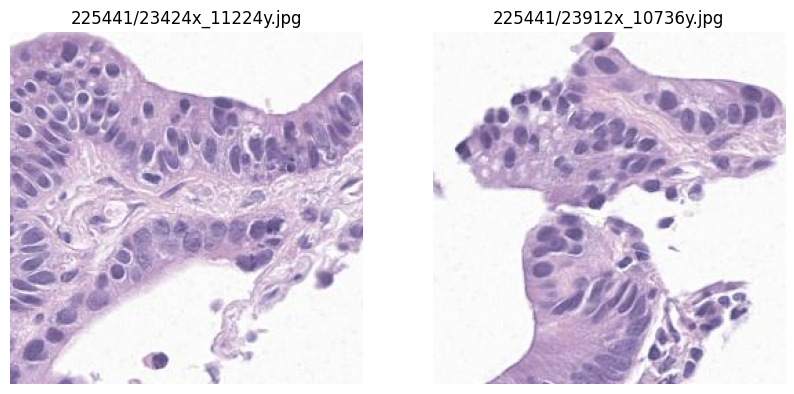

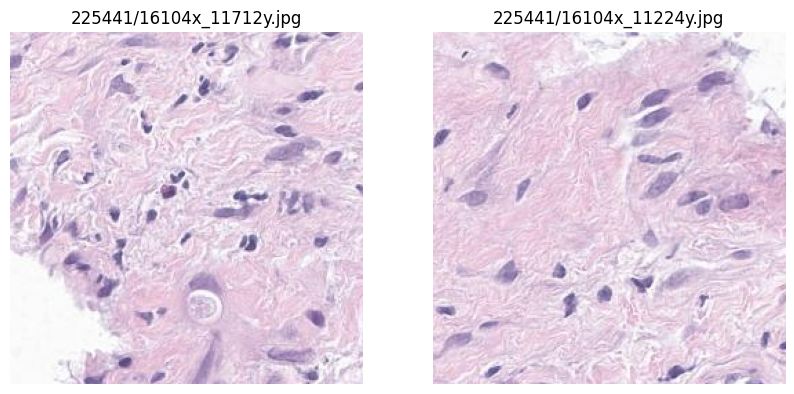

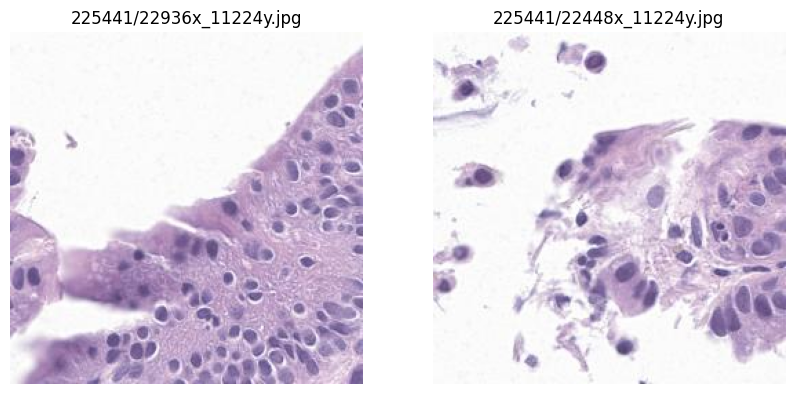

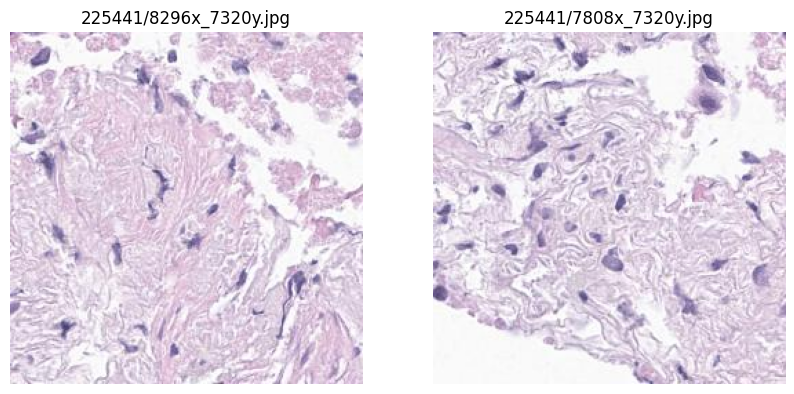

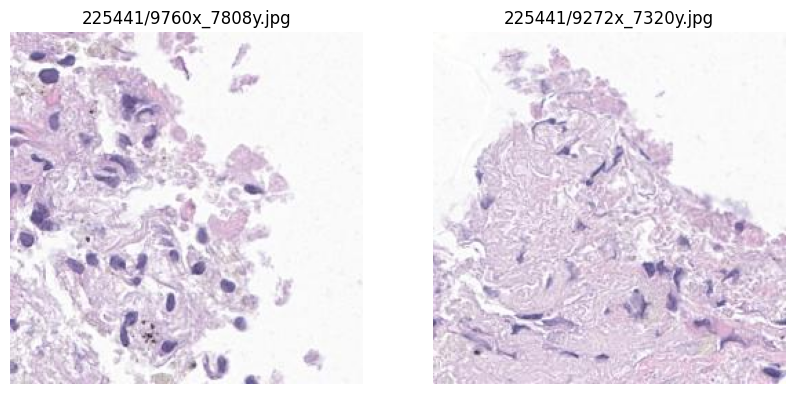

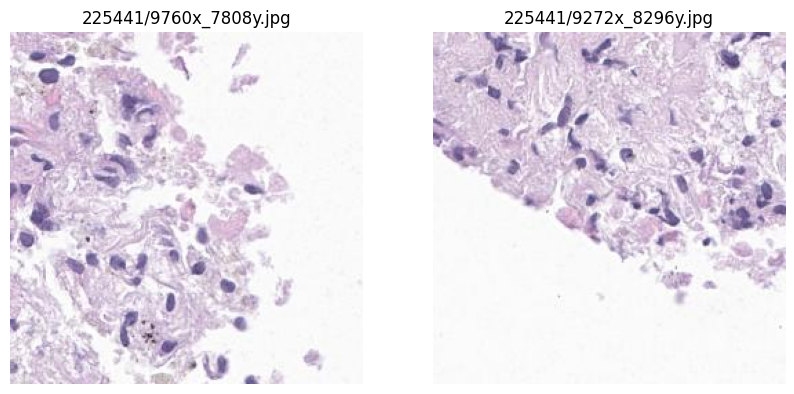

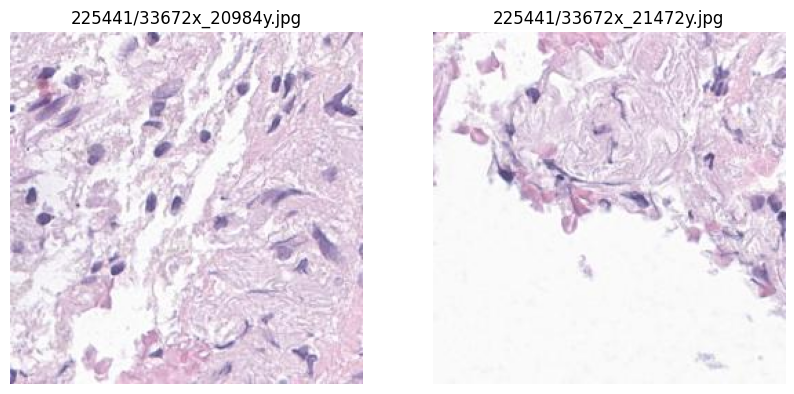

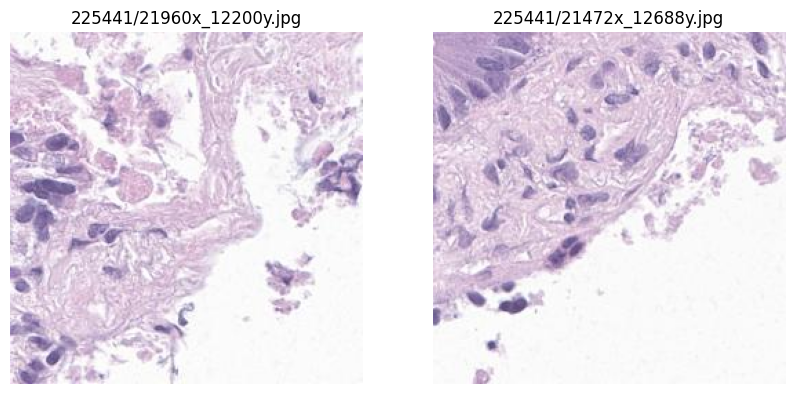

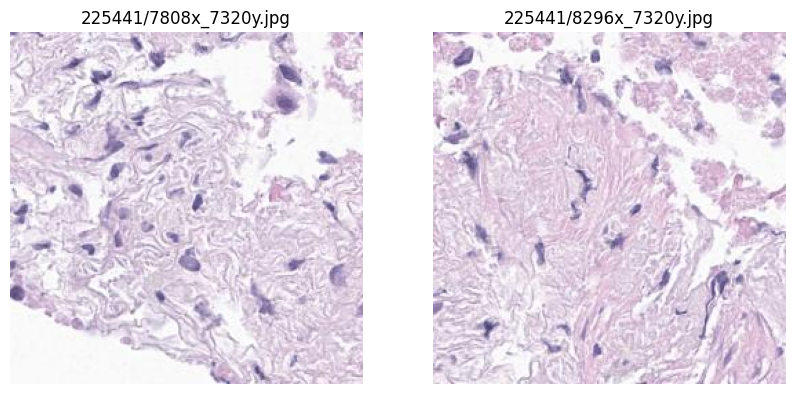

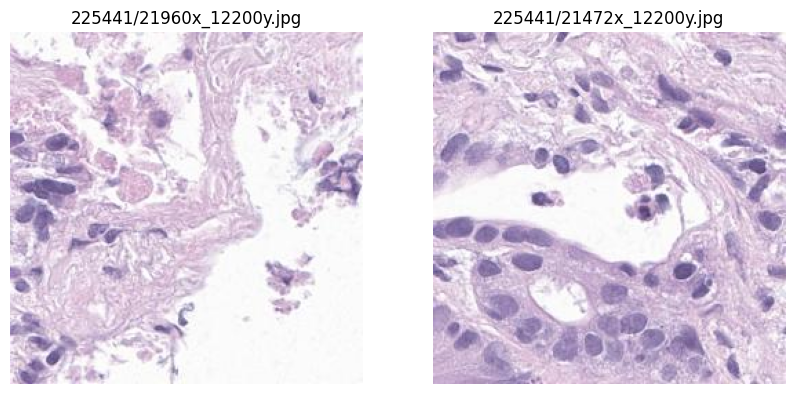

Number of levels:  3
Dimensions of each level:  ((43451, 29515), (10862, 7378), (2715, 1844))
Downsampling factors for each level:  (1.0, 4.0003414032441995, 16.00500842910959)


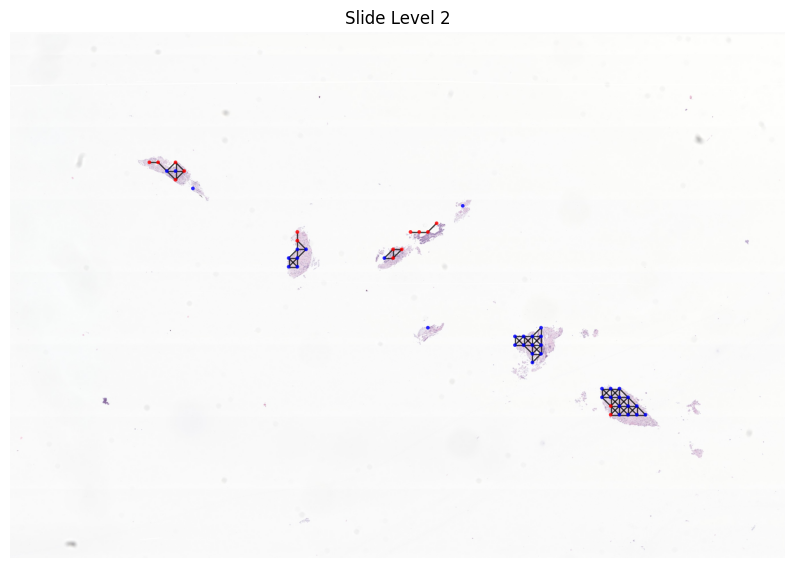

image id 327510
Top 10 Important Edges: [2063 1591 1138 1945 1943 1331  868 2494  731 1901]


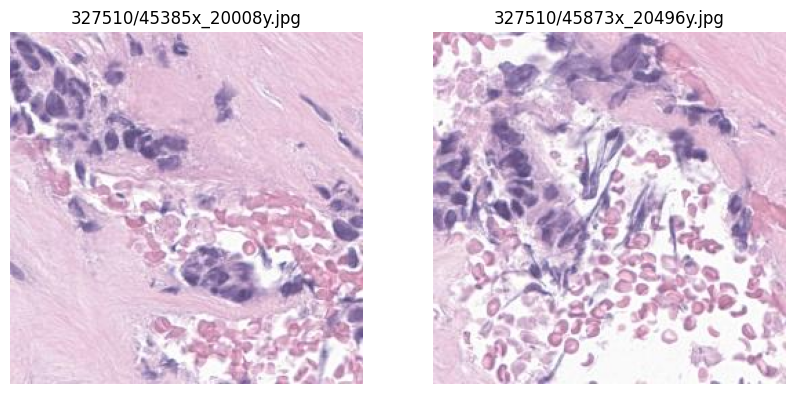

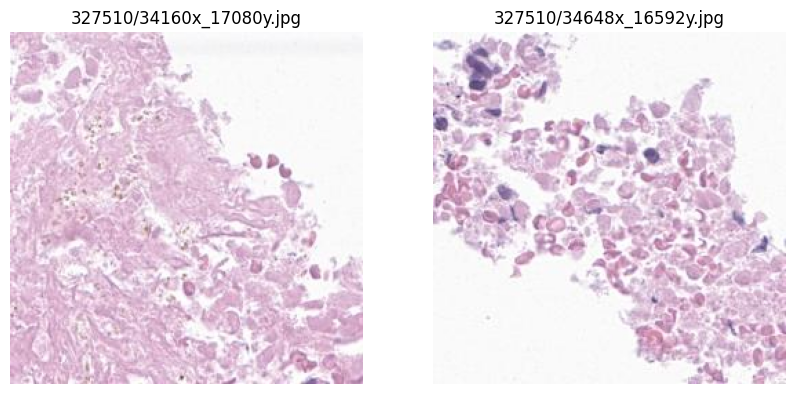

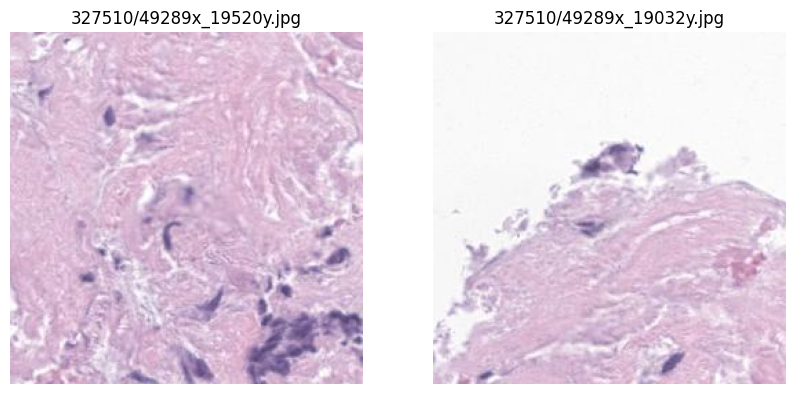

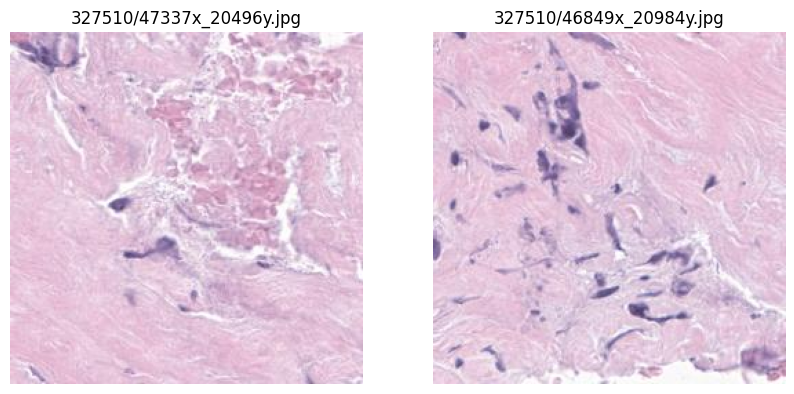

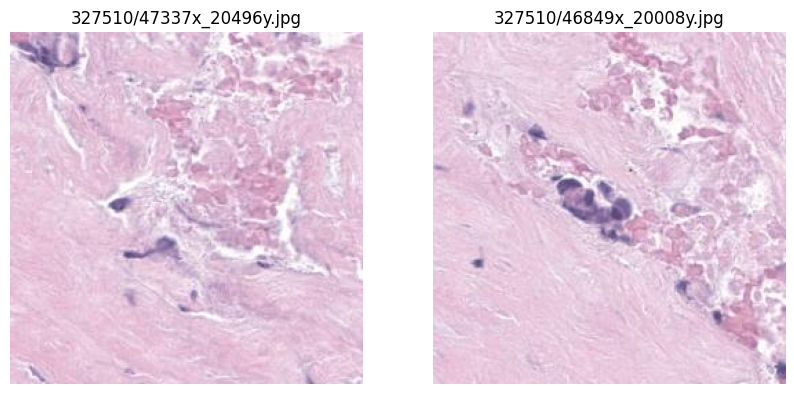

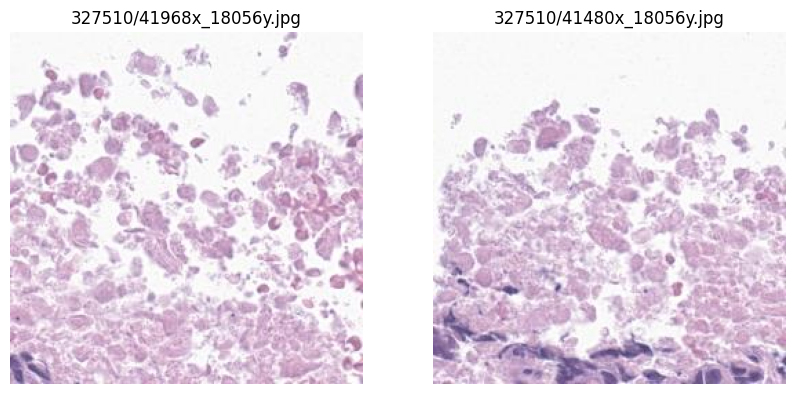

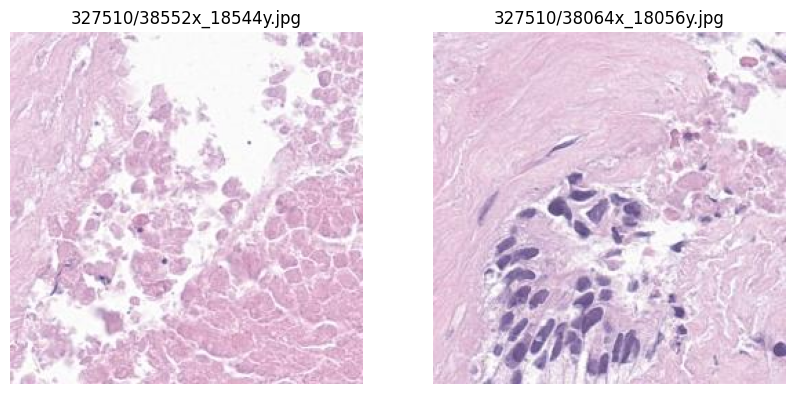

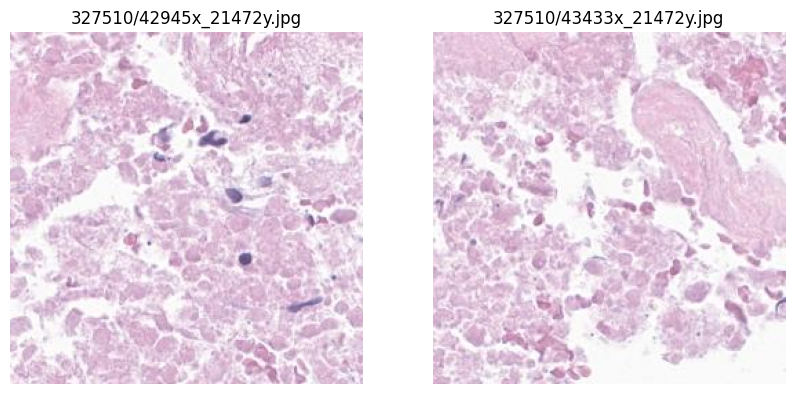

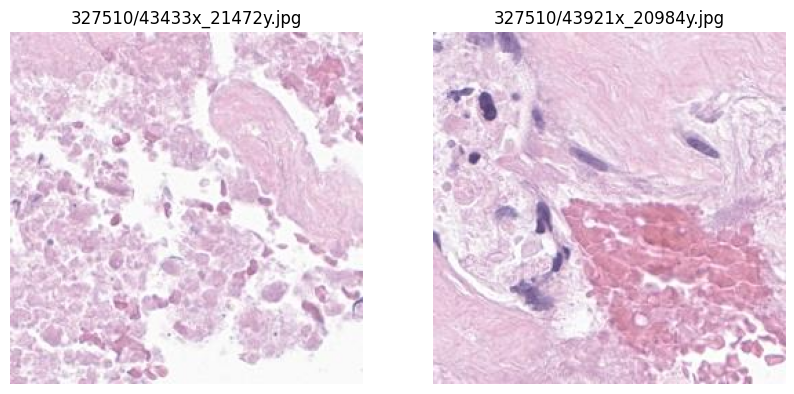

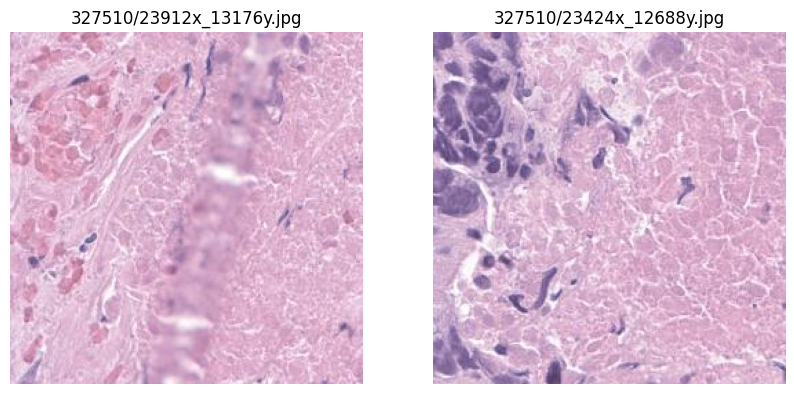

Number of levels:  3
Dimensions of each level:  ((57189, 29913), (14297, 7478), (3574, 1869))
Downsampling factors for each level:  (1.0, 4.000101835169366, 16.003107201017514)


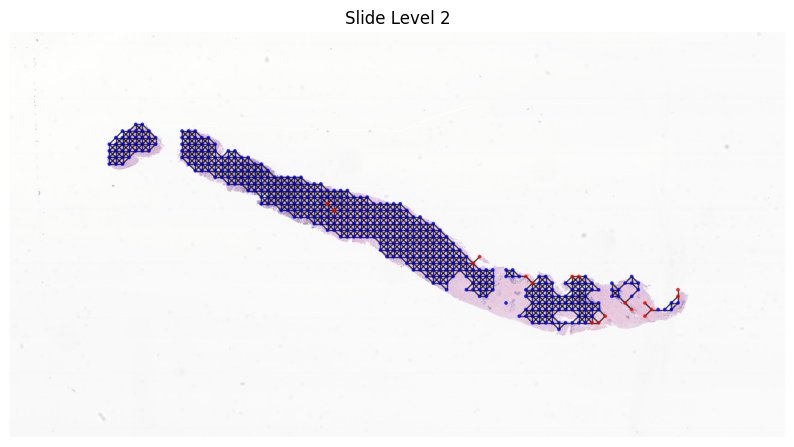

image id 225359
Top 10 Important Edges: [1219 2959 4417 2494 2874 2567 5000 6845 6283 3571]


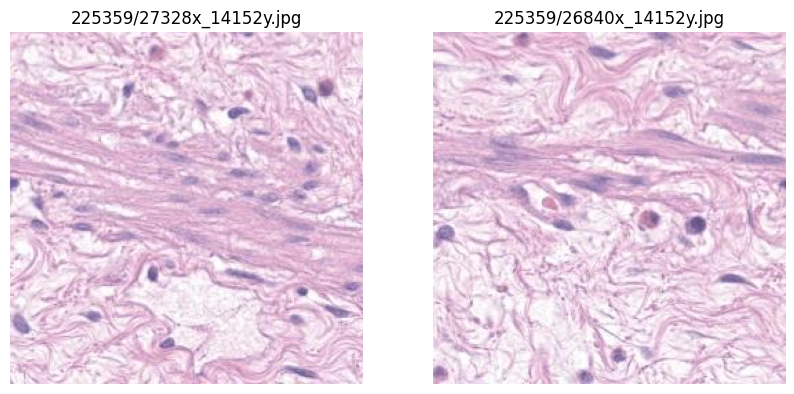

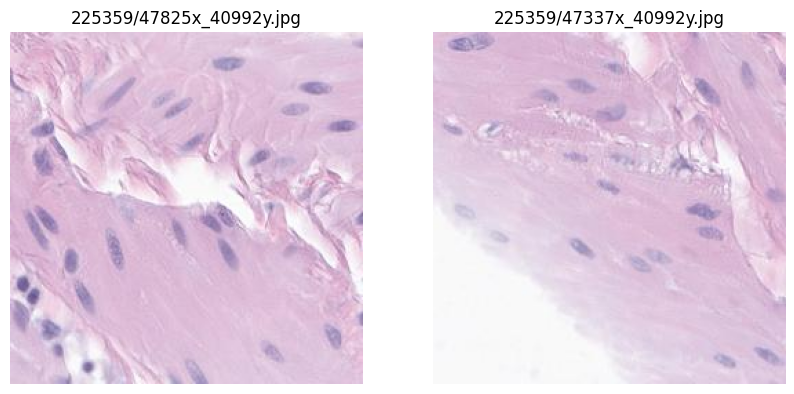

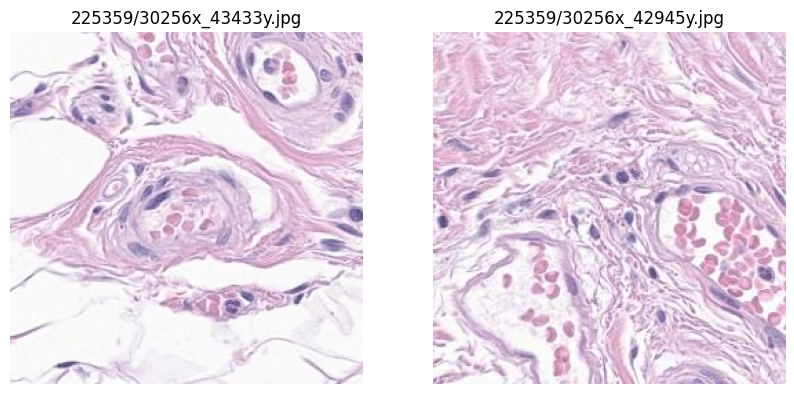

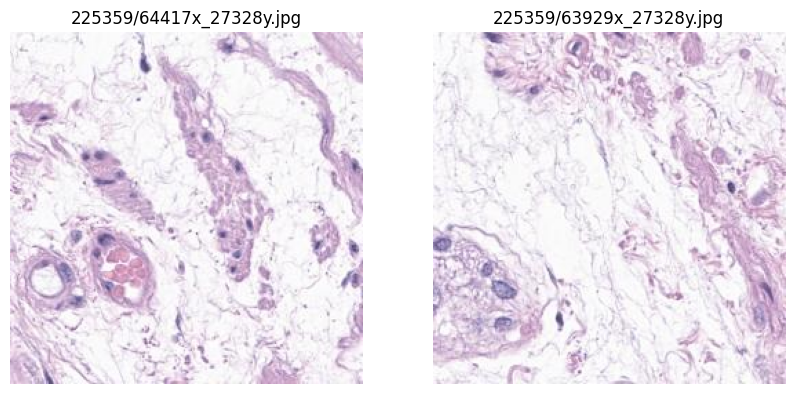

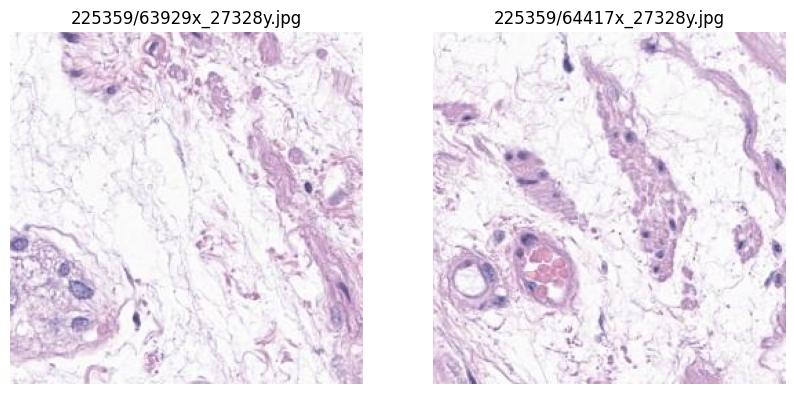

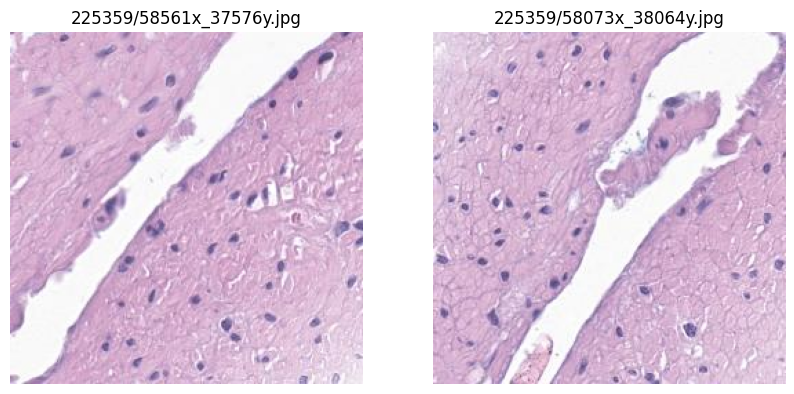

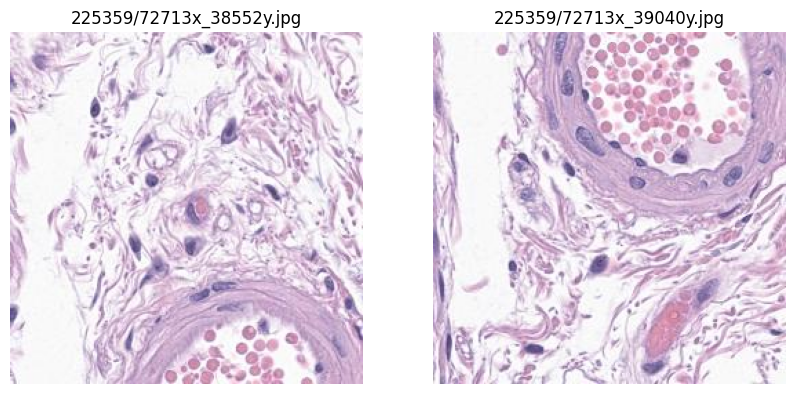

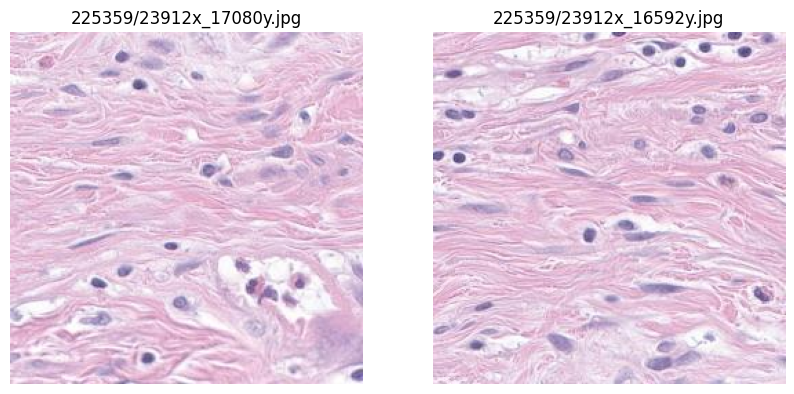

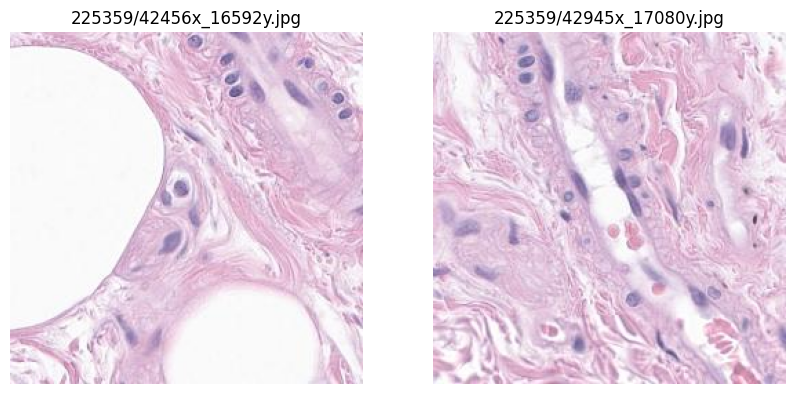

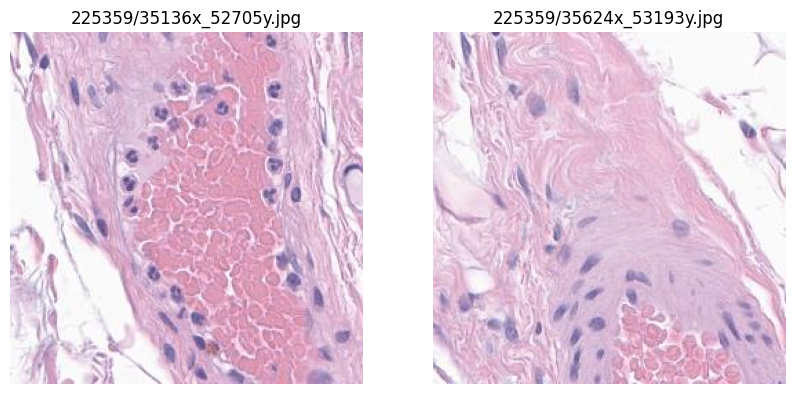

Number of levels:  4
Dimensions of each level:  ((98998, 70130), (24749, 17532), (6187, 4383), (1546, 1095))
Downsampling factors for each level:  (1.0, 4.000097444231022, 16.00071304189995, 64.04029547454914)


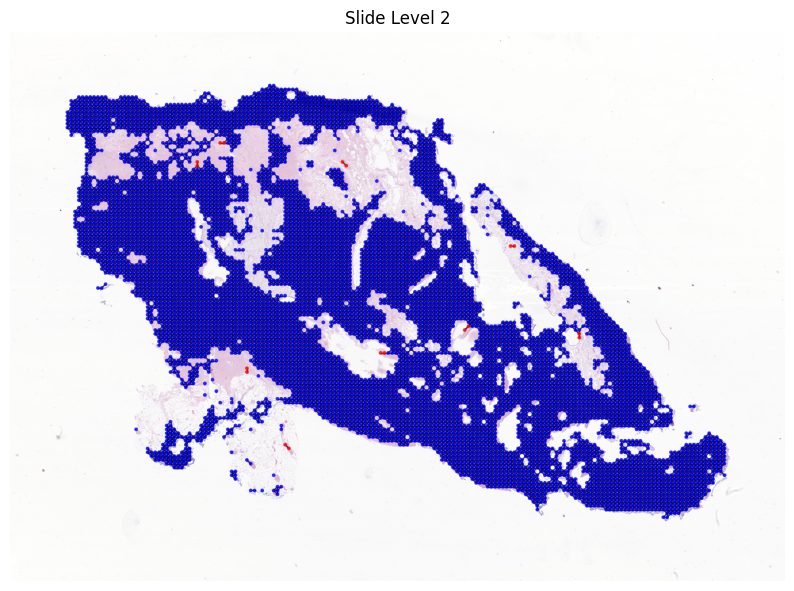

image id 327395
Top 10 Important Edges: [ 817 2159  450 2016  977 2312 1387  839 2202 1213]


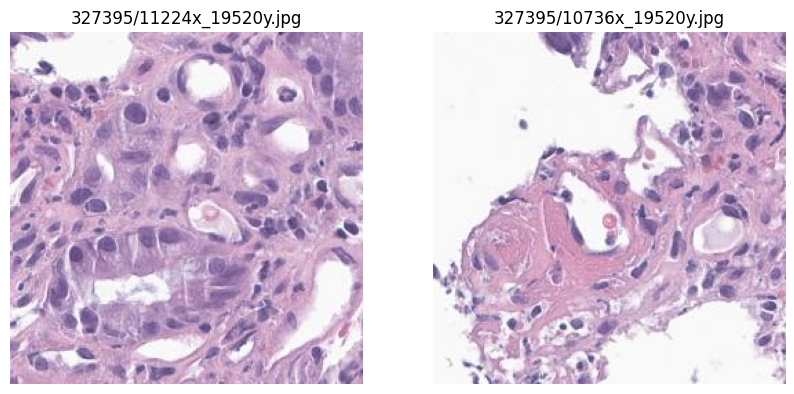

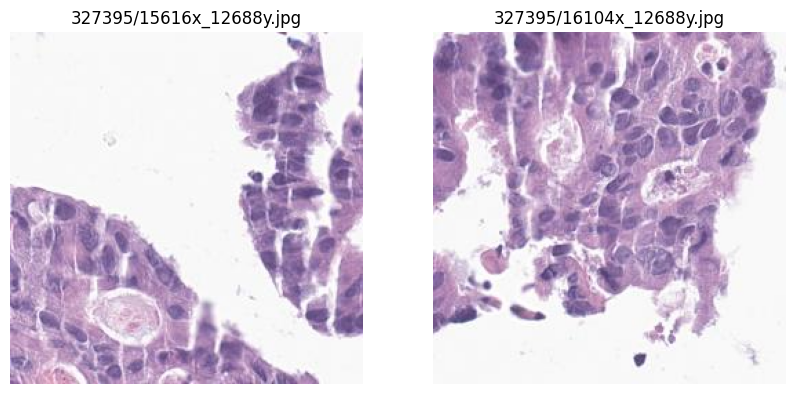

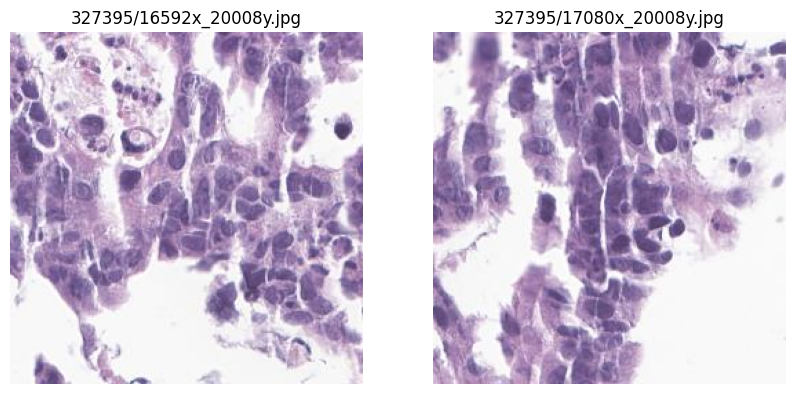

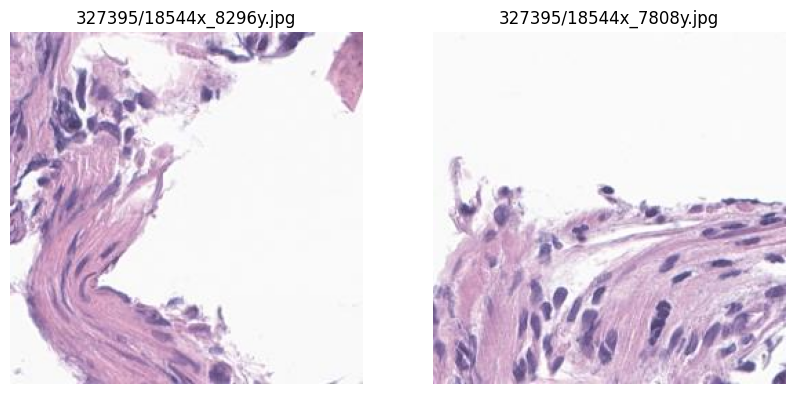

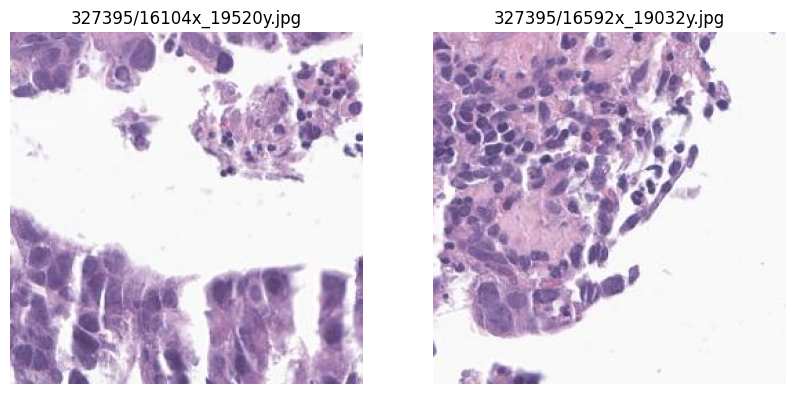

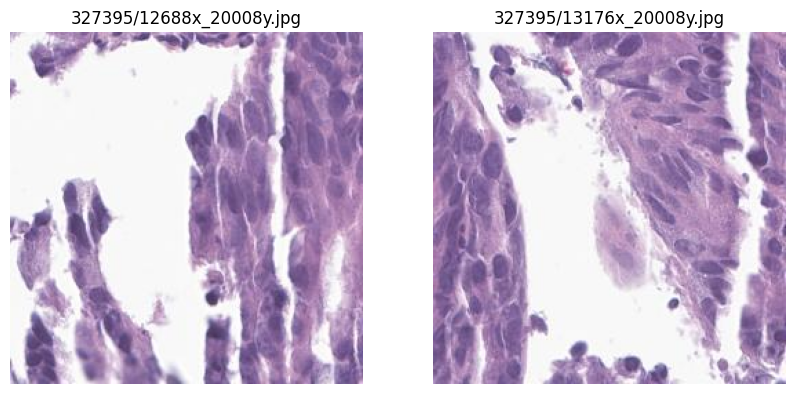

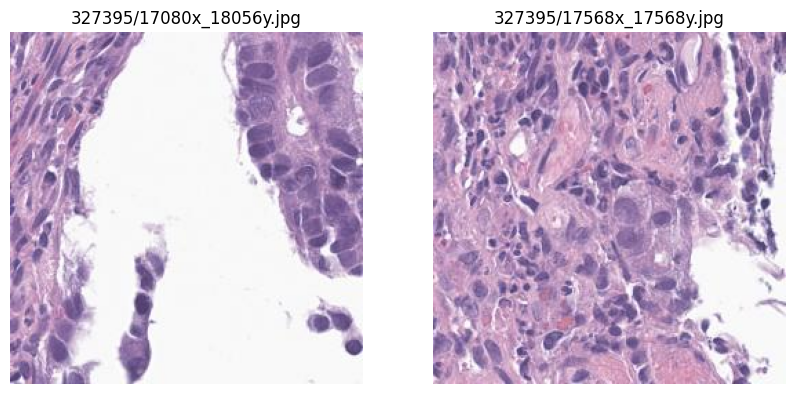

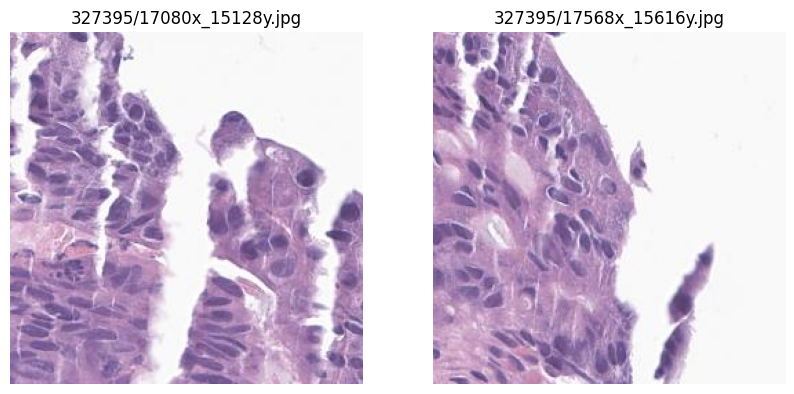

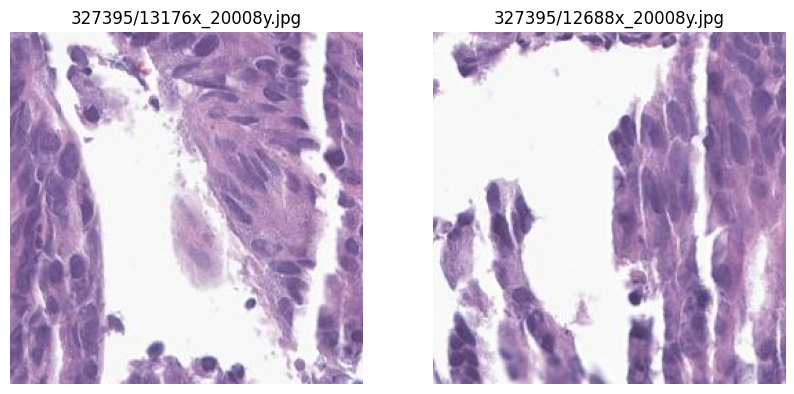

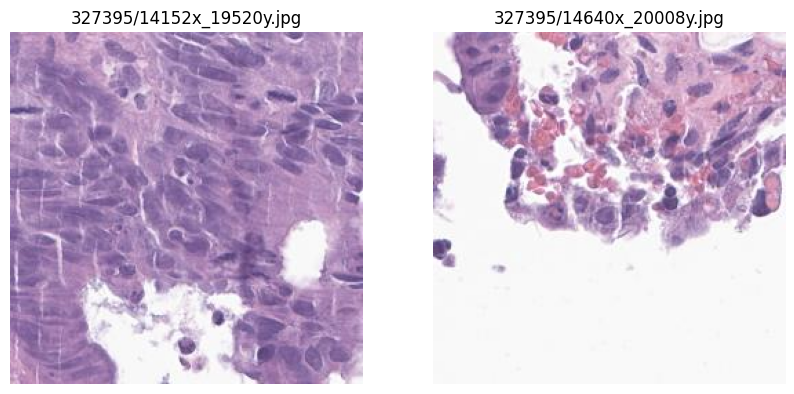

Number of levels:  3
Dimensions of each level:  ((29316, 28719), (7329, 7179), (1832, 1794))
Downsampling factors for each level:  (1.0, 4.000208942749687, 16.005272305063457)


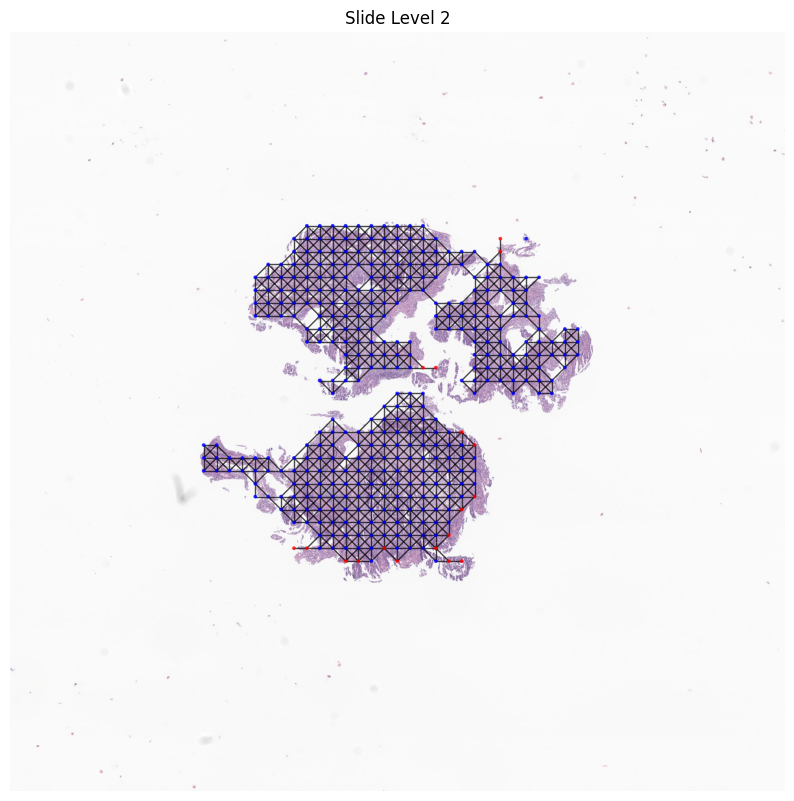

image id 189143
Top 10 Important Edges: [ 319  882 1665  674 1455 2011 1399 2042 2840  357]


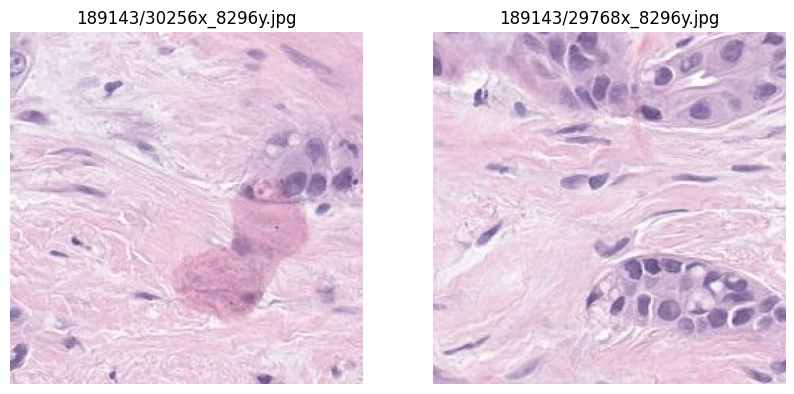

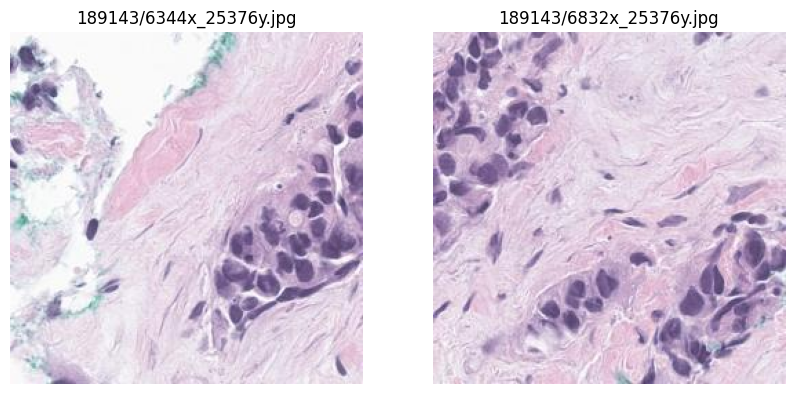

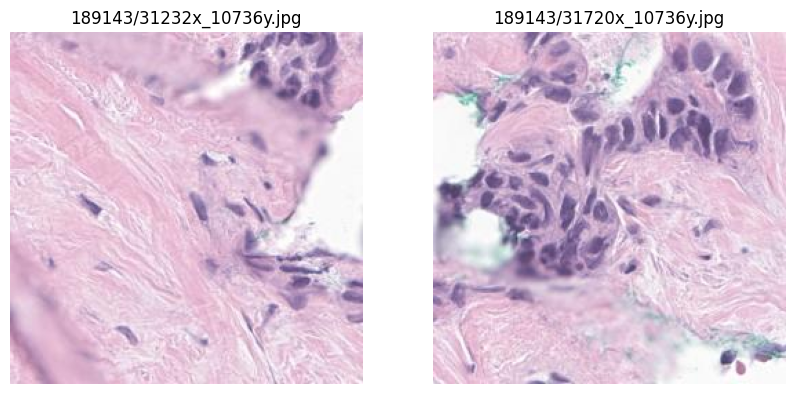

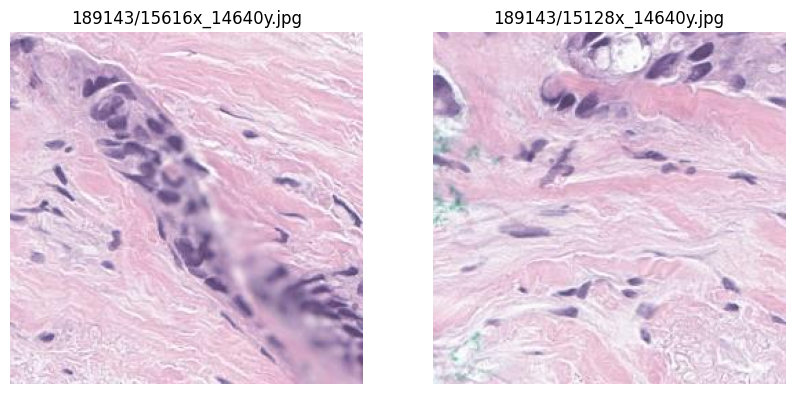

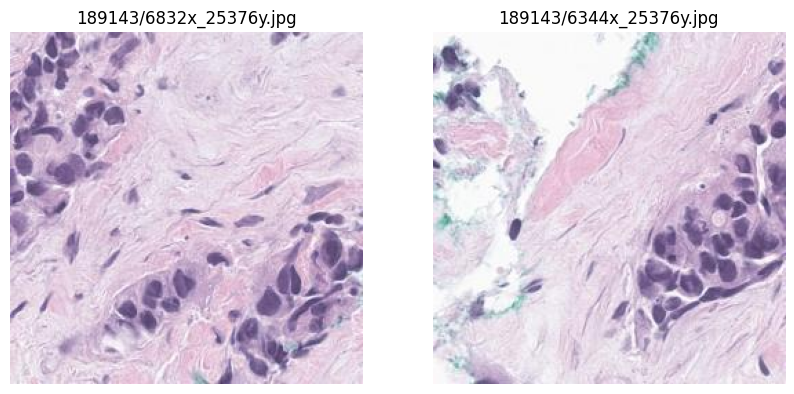

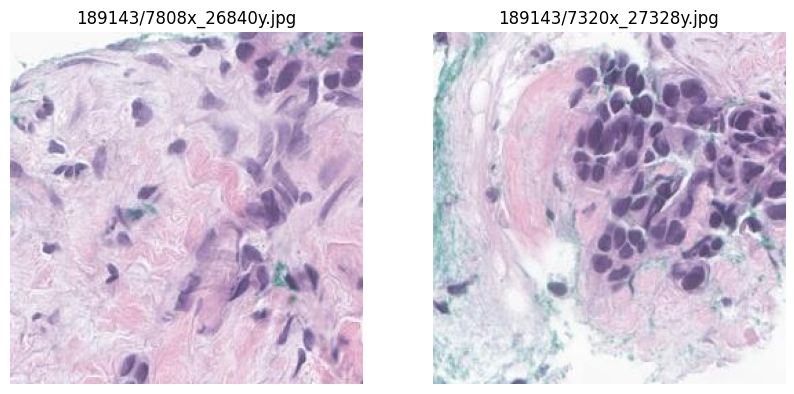

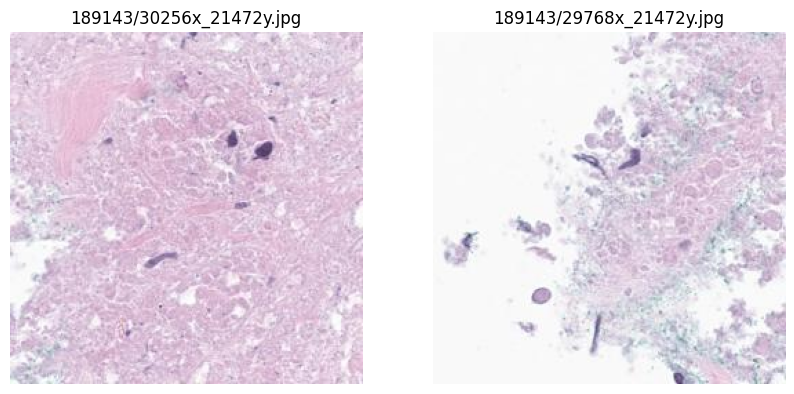

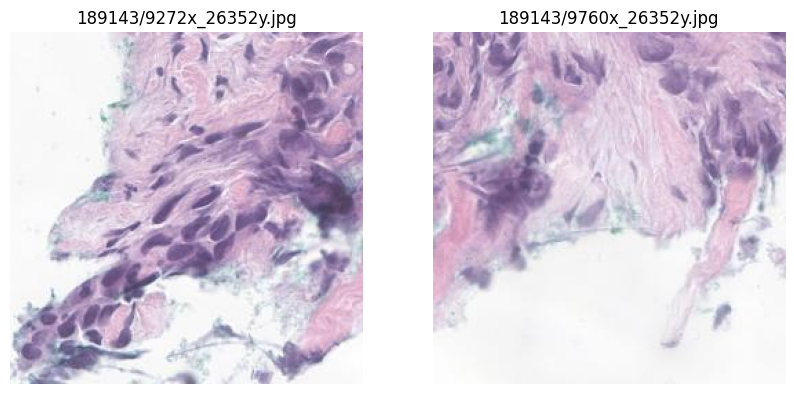

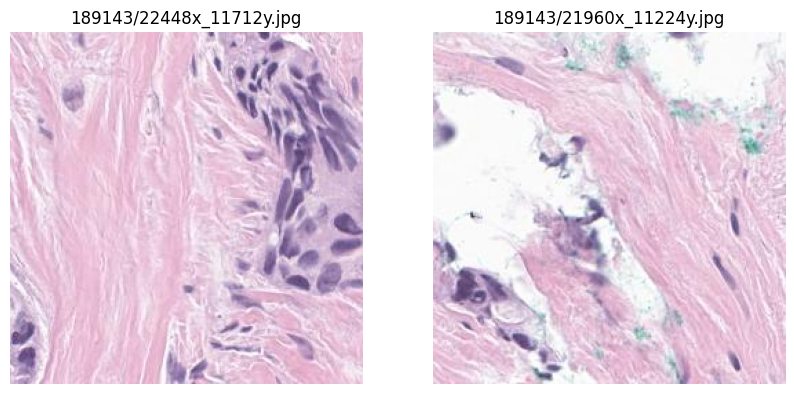

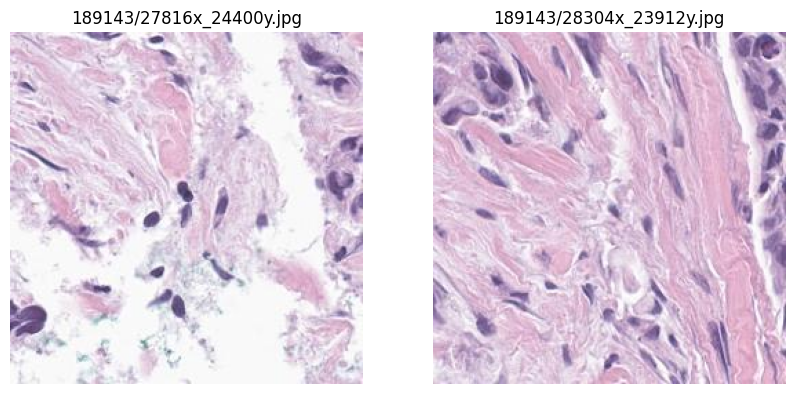

Number of levels:  3
Dimensions of each level:  ((40863, 36284), (10215, 9071), (2553, 2267))
Downsampling factors for each level:  (1.0, 4.00014684287812, 16.005584389936434)


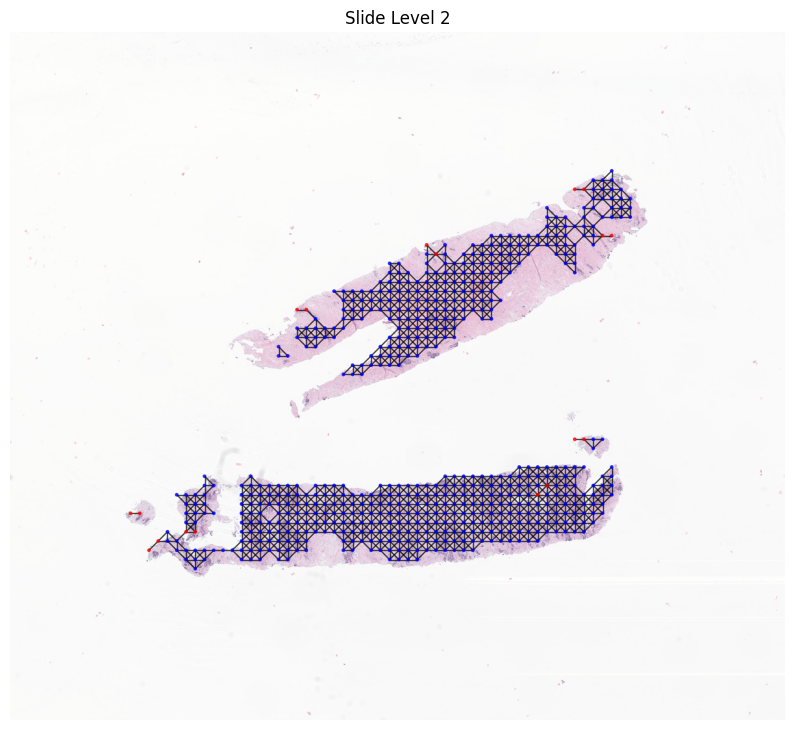

In [14]:
image_dir_path='../patch_embeddings/20XTiles/'

for ind in range(len(sub_id_list[:5])):
    batch = data_list[ind]
    id = sub_id_list[ind]
    print('image id', id)

    data_20x = batch
    if data_20x['edge_index'].shape[0]<2:
        continue
    data_20x = data_20x.to(device)
    output, attn = model(data_20x, True)
    preds = torch.argmax(output, dim=1).cpu().numpy()
    labels = data_20x.y.cpu().numpy()
    
    edge_importance = (attn[1]**2).sum(dim=1).cpu().detach().numpy()  # Sum of squares along the last dimension
    top10_indices = torch.topk(torch.tensor(edge_importance), 10).indices.numpy()
    
    highlight_nodes = []
    # print("Edge Importance:", edge_importance)
    print("Top 10 Important Edges:", top10_indices)

    id_df = crc20x_tumor_df[crc20x_tumor_df['ids']==id]
    for ind in top10_indices:
        x = int(data_20x.edge_index[0][ind].cpu())
        y = int(data_20x.edge_index[1][ind].cpu())
        coordx_1 = int(list(id_df.coord1)[int(x)])
        coordx_2 = int(list(id_df.coord2)[int(x)])
        image_name1 = str(id)+'/'+str(coordx_1)+'x_'+str(coordx_2)+'y.jpg'
        # print(coordx_1, coordx_2)
        # show_image_by_path(image_dir_path+image_name)
        image1 = load_image(image_dir_path + image_name1)


        coordy_1 = int(list(id_df.coord1)[int(y)])
        coordy_2 = int(list(id_df.coord2)[int(y)])
        image_name2 = str(id)+'/'+str(coordy_1)+'x_'+str(coordy_2)+'y.jpg'
        # print(coordy_1, coordy_2)
        # show_image_by_path(image_dir_path+image_name)
        image2 = load_image(image_dir_path + image_name2)
        if image1 is not None and image2 is not None:
                display_images_side_by_side(image1, image2, title1=image_name1, title2=image_name2)
        highlight_nodes.append(x)
        highlight_nodes.append(y)
    storage_key = list(image_dir_df[image_dir_df['images_id']==int(id)].storageKey)[0]
    slide_path = concentriq_dir+storage_key
    show_slide_info_with_graph(slide_path, data_20x.cpu(), data_20x.coordinates.cpu(), highlight_nodes=highlight_nodes, level=2)
    # plot_graph_highlight(data_20x.cpu(), data_20x.coordinates.cpu(), highlight_nodes=highlight_nodes)
